In [1]:
import pymc as pm
import matplotlib.pyplot as plt
import arviz as az
import pandas as pd
from scipy import special, stats
import numpy as np

In [2]:
az.style.use('arviz-darkgrid')
plt.rcParams['figure.dpi'] = 300

random_seed = 730612
cores = 4

In [6]:
birth = pd.read_csv("/content/bangladesh.csv")
birth = birth[["district", "use.contraception", "age.centered"]]

In [ ]:
birth

,district,use.contraception,age.centered
0,1,0,18.4400
1,1,0,-5.5599
2,1,0,1.4400
3,1,0,8.4400
4,1,0,-13.5590
...,...,...,...
1929,61,0,14.4400
1930,61,0,-4.5599
1931,61,0,14.4400
1932,61,0,-13.5600


**Pooled Model**

For my pooled, unpooled and hierarchical models, I chose a normal distribution for B0, centered at 50%. If B1 is zero, B0=0 is a good estimate for contraception proportion at the mean average age. Sigma is larger than the usually STDV of 2 because of the wide range of values in predictor variables. B1 is normally distributed with mu=0. This implies that age will have no affect on contraception, which is a good null hypothesis.

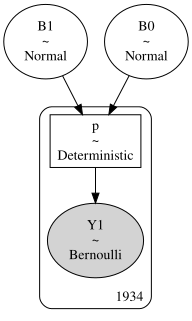

In [7]:
with pm.Model() as pooled_model:
    Y = birth["use.contraception"]
    B0 = pm.Normal('B0', mu=0.5, sigma=10) #intercept
    B1 = pm.Normal('B1', mu=0, sigma=10) #age

    eta = B0 + B1*birth["age.centered"]
    p = pm.Deterministic('p', pm.invlogit(eta))
    Y1 = pm.Bernoulli('Y1', p=p, observed=Y)

pm.model_to_graphviz(pooled_model)

In [8]:
with pooled_model:
    pooled_trace = pm.sample(random_seed=random_seed)

array([[<Axes: title={'center': 'B0'}>, <Axes: title={'center': 'B0'}>],
       [<Axes: title={'center': 'B1'}>, <Axes: title={'center': 'B1'}>],
       [<Axes: title={'center': 'p'}>, <Axes: title={'center': 'p'}>]],
      dtype=object)

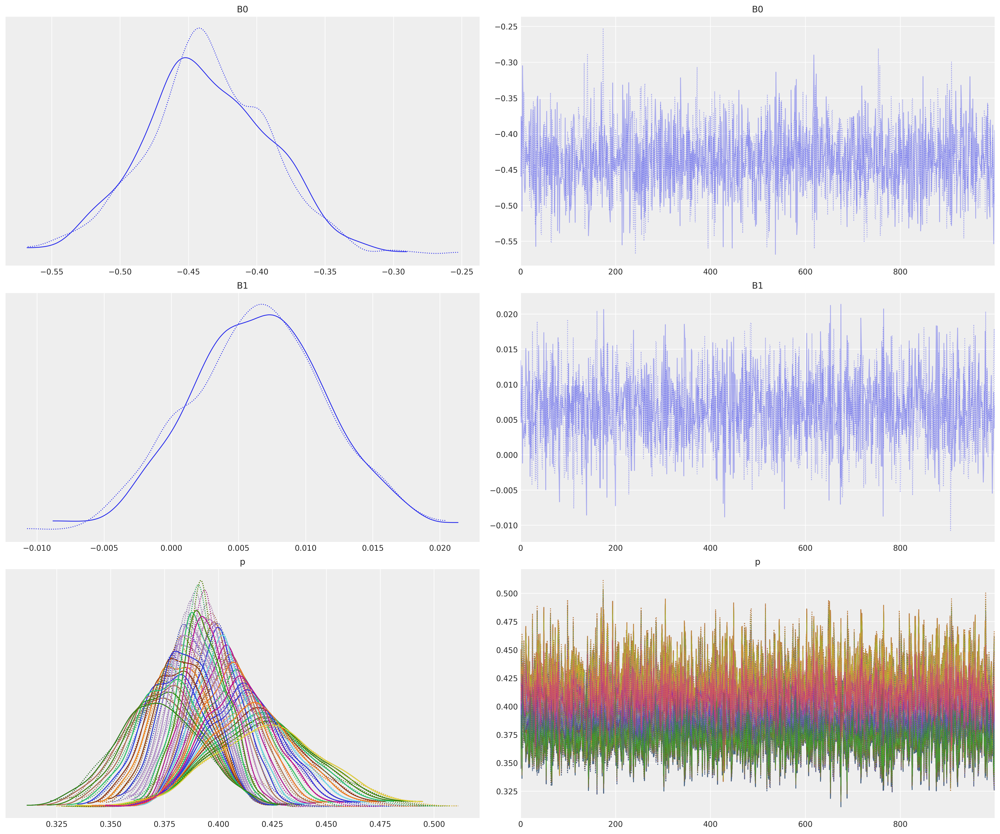

In [9]:
#trace plots
az.plot_trace(pooled_trace, figsize = (18,15))

In [10]:
az.summary(pooled_trace, var_names=["B0", "B1"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
B0,-0.436,0.046,-0.524,-0.351,0.001,0.001,2439.0,1547.0,1.0
B1,0.006,0.005,-0.003,0.016,0.000,0.000,2444.0,1604.0,1.0


The r_hat is = 1 for both B0 and B1, indicating a well performing chain. B0 mean is -0.436. This suggests that when age = 0 (the mean), the contraception log odds is -0.436. B1 mean is 0.006 log odds, indicating a slight incline (slope). This suggests that as age increase, so does contraception proportion, when ignorning district.

<Figure size 3000x7200 with 0 Axes>

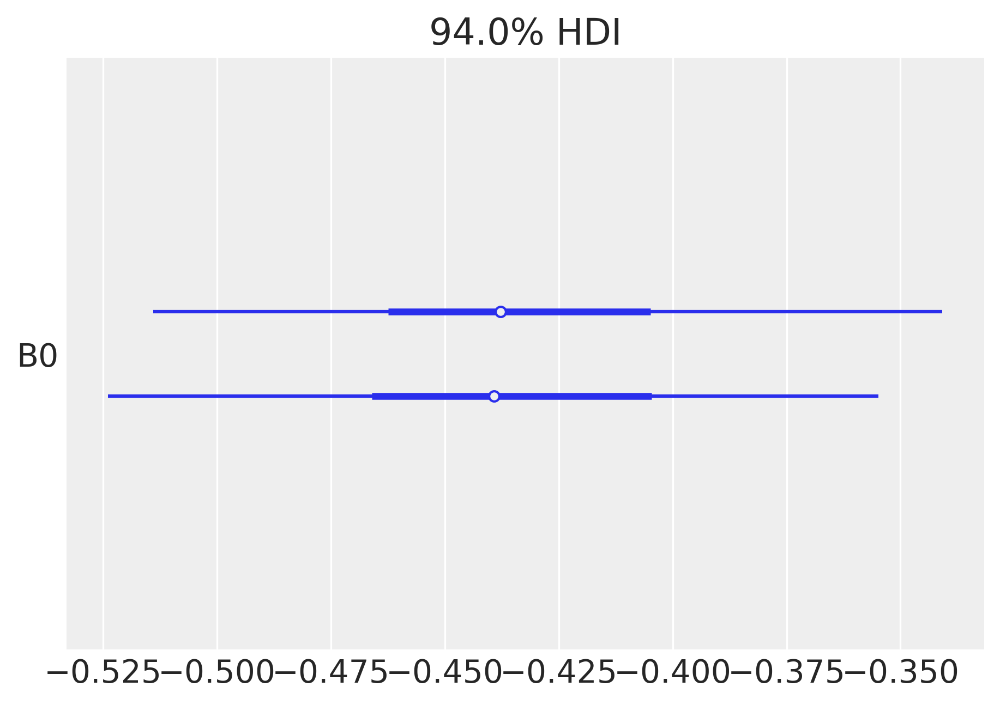

In [11]:
plt.figure(figsize=(10,24))
az.plot_forest(pooled_trace, var_names=['B0']);

<Figure size 3000x7200 with 0 Axes>

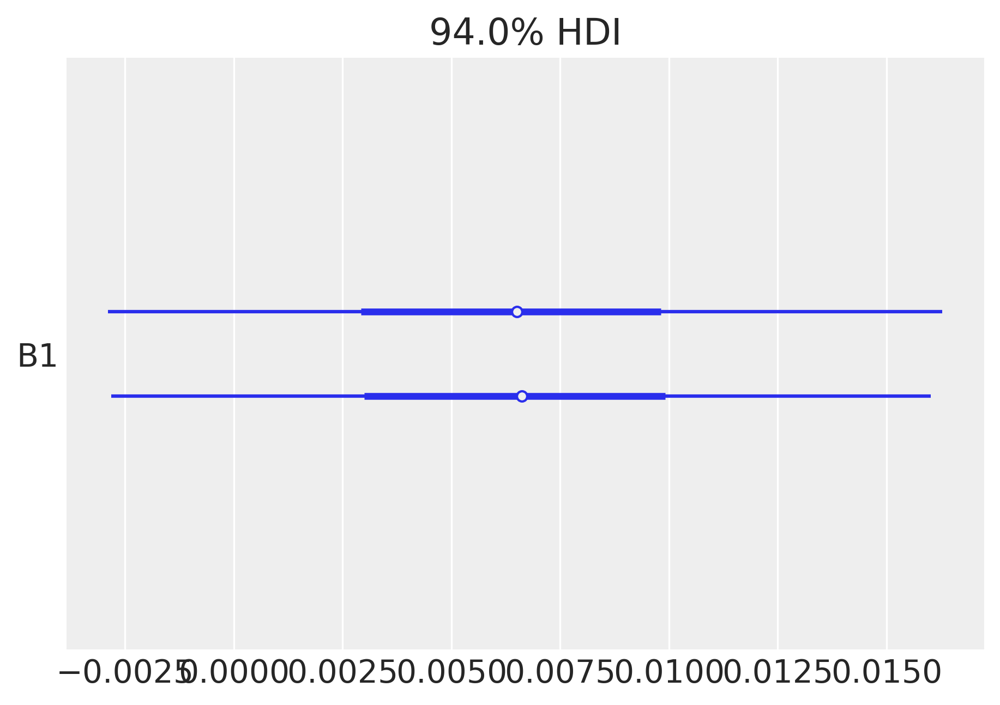

In [12]:
plt.figure(figsize=(10,24))
az.plot_forest(pooled_trace, var_names=['B1']);

The plots above have a relatively small varience for B0 and B1 likely because the model is using ALL datapoints to estimate these values.

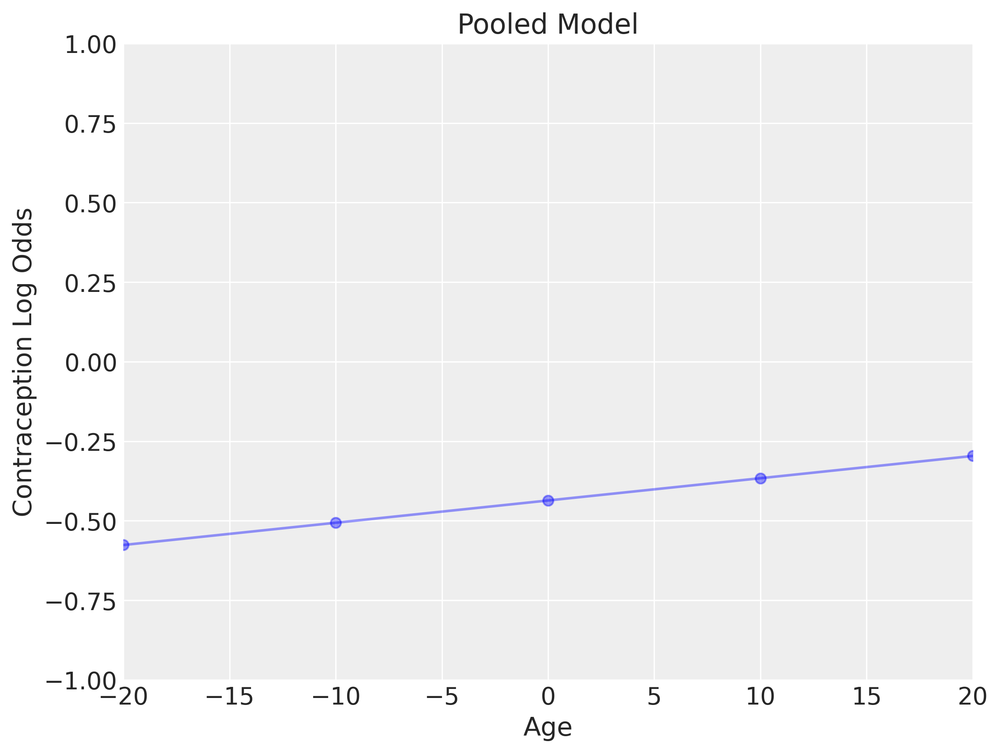

In [13]:
import numpy as np
import matplotlib.pyplot as plt

b = -0.4363
m = 0.007

# Generate a range of age values
xvals = np.arange(-20, 21, 10)

# Calculate the corresponding contraception proportions for each age
yvals = m * xvals + b

# Create the plot
plt.figure(figsize=(8, 6))
plt.plot(xvals, yvals, 'bo-', alpha=0.4)
plt.xlim(-20, 20)  # Adjust the x-axis limits
plt.ylim(-1,1)
plt.xlabel("Age")
plt.ylabel("Contraception Log Odds")
plt.title("Pooled Model")
plt.show()

**Unpooled Model**

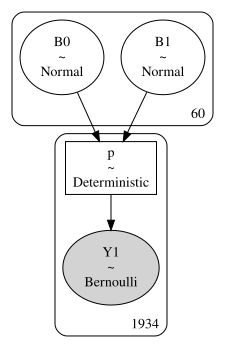

In [14]:
#separate betas for each district(60 total)
district_idx = birth["district"].astype('category').cat.codes.values
district_code = birth["district"].astype('category').cat.categories
n_districts = district_code.size

with pm.Model() as unpooled_model:
    Y = birth["use.contraception"]
    B0 = pm.Normal('B0', mu=0, sigma=10, shape=n_districts) #intercept for each district
    B1 = pm.Normal('B1', mu=0, sigma=10, shape=n_districts) #age

    eta = B0[district_idx] + B1[district_idx]*birth["age.centered"]
    p = pm.Deterministic('p', pm.invlogit(eta))
    Y1 = pm.Bernoulli('Y1', p=p, observed=Y)

pm.model_to_graphviz(unpooled_model)

In [15]:
with unpooled_model:
    unpooled_trace = pm.sample(1000, tune=2000, random_seed=random_seed, cores=2)

array([[<Axes: title={'center': 'B0'}>, <Axes: title={'center': 'B0'}>],
       [<Axes: title={'center': 'B1'}>, <Axes: title={'center': 'B1'}>]],
      dtype=object)

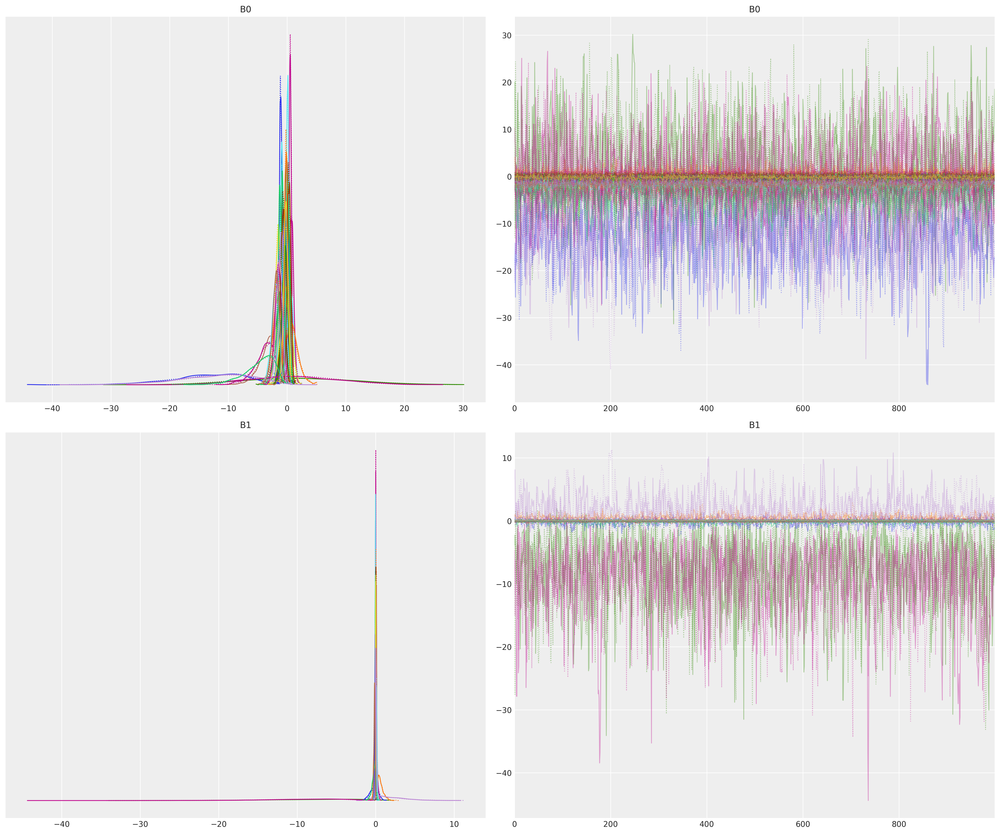

In [16]:
#trace plots
az.plot_trace(unpooled_trace, figsize = (18,15), var_names=["B0", "B1"])

In [17]:
az.summary(unpooled_trace, var_names=["B0", "B1"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
B0[0],-1.089,0.215,-1.510,-0.714,0.006,0.004,1464.0,1266.0,1.0
B0[1],-0.600,0.516,-1.593,0.355,0.015,0.013,1216.0,951.0,1.0
B0[2],1.921,9.752,-16.296,19.698,0.269,0.224,1314.0,1219.0,1.0
B0[3],-0.004,0.399,-0.696,0.818,0.011,0.009,1319.0,1058.0,1.0
B0[4],-0.644,0.344,-1.298,-0.063,0.008,0.006,2053.0,1468.0,1.0
...,...,...,...,...,...,...,...,...,...
B1[55],0.106,0.067,-0.013,0.243,0.002,0.002,1215.0,1040.0,1.0
B1[56],0.014,0.035,-0.052,0.078,0.001,0.001,1811.0,1185.0,1.0
B1[57],-0.239,0.257,-0.750,0.151,0.011,0.009,739.0,593.0,1.0
B1[58],0.030,0.054,-0.064,0.140,0.001,0.001,1354.0,1223.0,1.0


<Figure size 3000x7200 with 0 Axes>

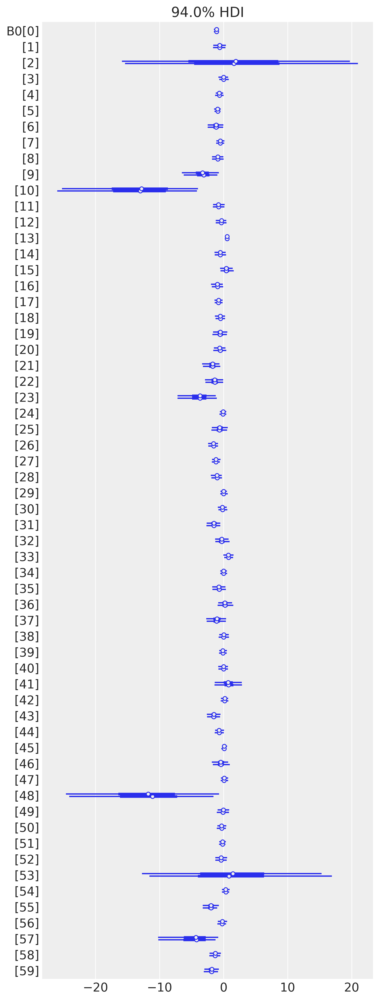

In [18]:
plt.figure(figsize=(10,24))
az.plot_forest(unpooled_trace, var_names=['B0']);

<Figure size 3000x7200 with 0 Axes>

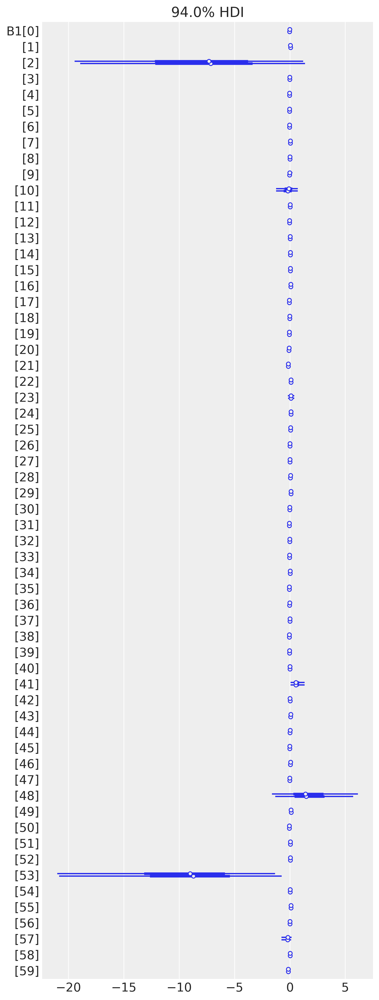

In [19]:
plt.figure(figsize=(10,24))
az.plot_forest(unpooled_trace, var_names=['B1']);

The above graphs indicate a large difference in log odds contraception varience between districts, due to varying number of data points in each district.

In [20]:
b = unpooled_trace.posterior['B0'].mean(dim=['draw', 'chain'])
m = unpooled_trace.posterior['B1'].mean(dim=['draw', 'chain'])

Text(0.5, 1.0, 'Unpooled')

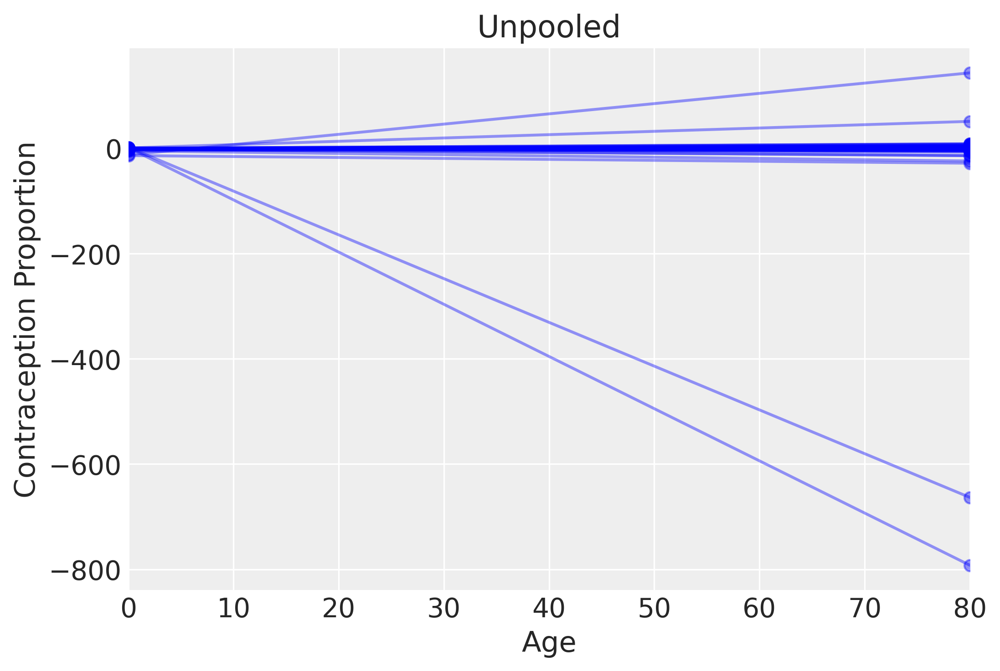

In [21]:

# Generate a range of age values
xvals = [0,80]

# Calculate y-values for each district and x value
for bi, mi in zip(b, m):
  plt.plot(xvals, [mi*xvals[0] + bi, mi*xvals[1] + bi], 'bo-', alpha=0.4)


plt.xlim(0, 80)  # Adjust the x-axis limits
plt.xlabel("Age")
plt.ylabel("Contraception Proportion")
plt.title("Unpooled")


The above line graph suggests that the affect of age on log odds contraception is different between districts.

**Hierarchical model**

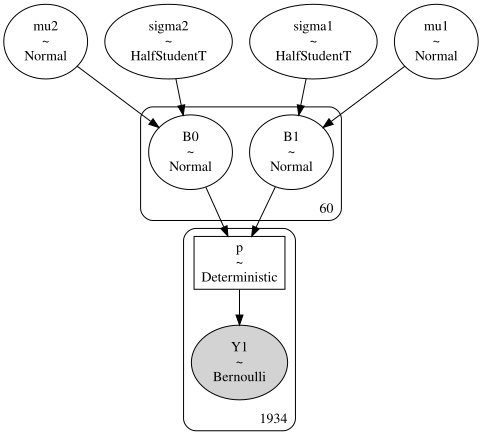

In [22]:
#two separate thetas. One for district_idx and one for age_idx.

district_idx = birth["district"].astype('category').cat.codes.values
district_code = birth["district"].astype('category').cat.categories
n_districts = district_code.size

with pm.Model() as hierarchical_model:
    Y = birth["use.contraception"]

    #district
    mu2 = pm.Normal("mu2", mu=0, sigma=10)
    sigma2 = pm.HalfStudentT("sigma2", 2,9)
    B0 = pm.Normal("B0", mu=mu2, sigma=sigma2, shape=n_districts)

    #age
    mu1 = pm.Normal("mu1", mu=0, sigma=10)
    sigma1 = pm.HalfStudentT("sigma1", 2,9)
    B1 = pm.Normal("B1", mu=mu1, sigma=sigma1, shape=n_districts)

    eta = B0[district_idx] + B1[district_idx]*birth["age.centered"]
    p = pm.Deterministic('p', pm.invlogit(eta))
    Y1 = pm.Bernoulli('Y1', p=p, observed=Y)

pm.model_to_graphviz(hierarchical_model)

In [23]:
with hierarchical_model:
    hierarchical_trace = pm.sample(1000, tune=2000, random_seed=random_seed, cores=2)

array([[<Axes: title={'center': 'B0'}>, <Axes: title={'center': 'B0'}>],
       [<Axes: title={'center': 'B1'}>, <Axes: title={'center': 'B1'}>]],
      dtype=object)

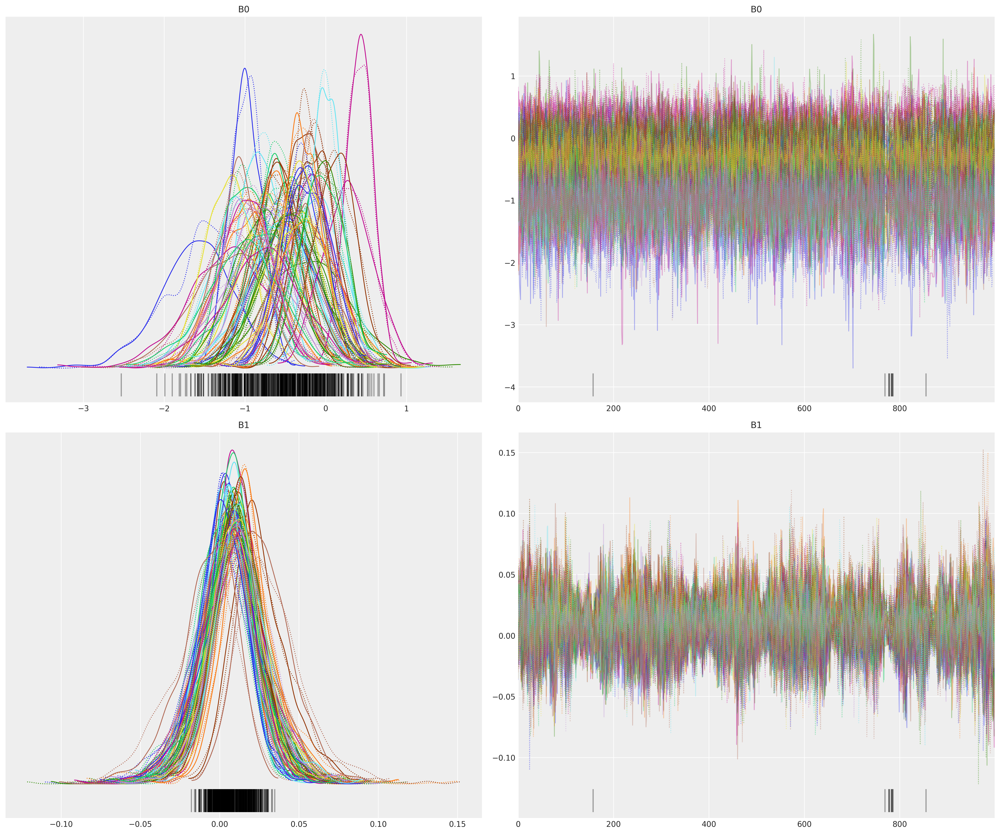

In [24]:
#trace plots
az.plot_trace(hierarchical_trace, figsize = (18,15), var_names=["B0", "B1"])

In [25]:
#sampling performance
az.summary(hierarchical_trace, var_names=["B0", "B1"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
B0[0],-0.995,0.194,-1.368,-0.652,0.004,0.003,1930.0,1312.0,1.0
B0[1],-0.580,0.379,-1.248,0.152,0.010,0.008,1482.0,1018.0,1.0
B0[2],-0.210,0.515,-1.206,0.751,0.011,0.011,2149.0,1239.0,1.0
B0[3],-0.180,0.316,-0.745,0.416,0.009,0.007,1206.0,742.0,1.0
B0[4],-0.574,0.276,-1.081,-0.054,0.006,0.004,2412.0,1265.0,1.0
...,...,...,...,...,...,...,...,...,...
B1[55],0.014,0.019,-0.020,0.054,0.001,0.001,1342.0,1028.0,1.0
B1[56],0.010,0.017,-0.023,0.041,0.000,0.000,1937.0,1284.0,1.0
B1[57],0.008,0.019,-0.029,0.043,0.000,0.000,1984.0,1234.0,1.0
B1[58],0.012,0.019,-0.020,0.052,0.000,0.001,1581.0,872.0,1.0


<Figure size 3000x7200 with 0 Axes>

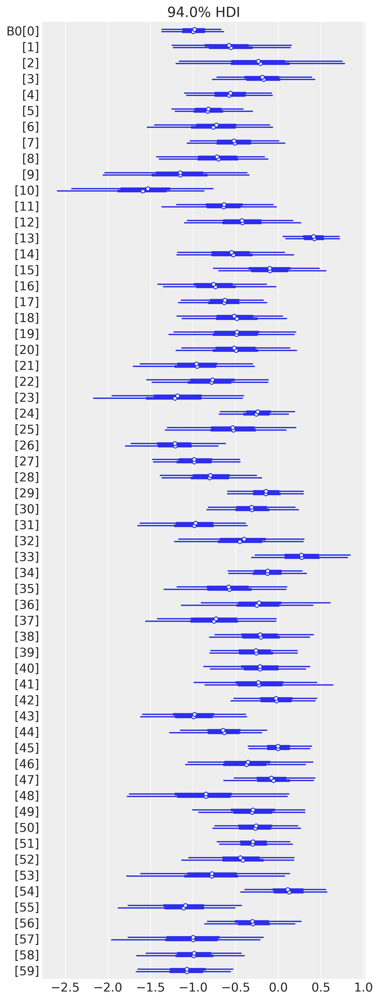

In [26]:
plt.figure(figsize=(10,24))
az.plot_forest(hierarchical_trace, var_names=['B0']);

<Figure size 3000x7200 with 0 Axes>

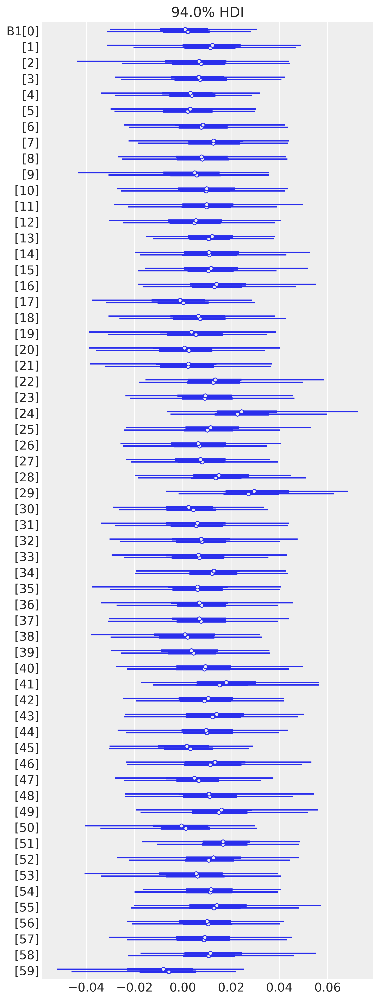

In [27]:
plt.figure(figsize=(10,24))
az.plot_forest(hierarchical_trace, var_names=['B1']);

The above graphs indicate a small difference in log odds contraception varience between districts, due to hyperparamters for B0 and B1 for each district.

Text(0.5, 1.0, 'Hierarchical Model')

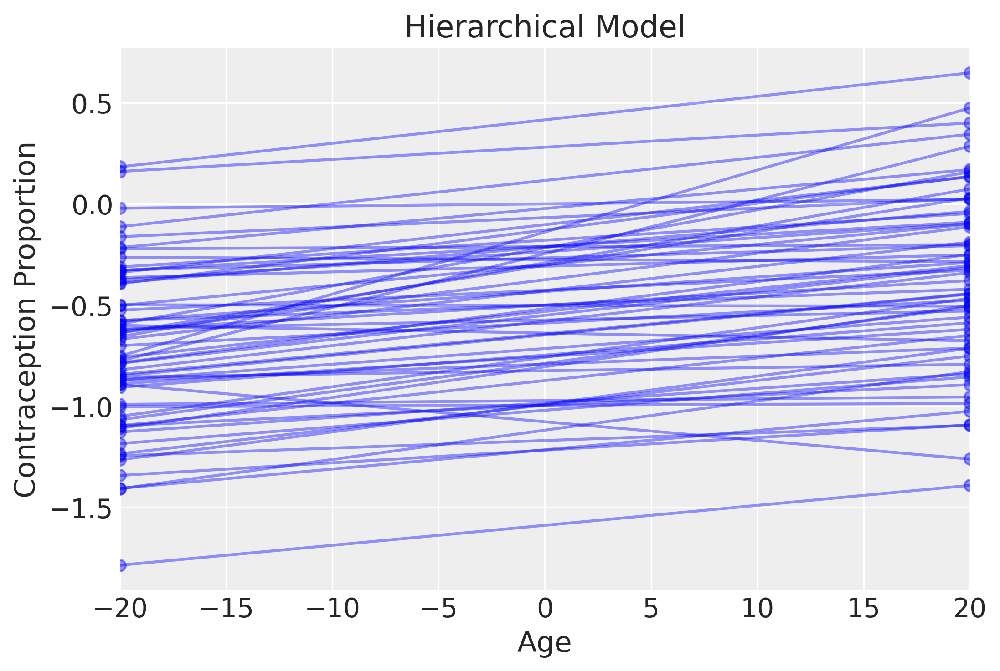

In [29]:
b = hierarchical_trace.posterior['B0'].mean(dim=['draw', 'chain'])
m = hierarchical_trace.posterior['B1'].mean(dim=['draw', 'chain'])

# Generate a range of age values
xvals = [-20,20]

# Calculate y-values for each district and x value
for bi, mi in zip(b, m):
  plt.plot(xvals, [mi*xvals[0] + bi, mi*xvals[1] + bi], 'bo-', alpha=0.4)


plt.xlim(-20,20)  # Adjust the x-axis limits
plt.xlabel("Age")
plt.ylabel("Contraception Proportion")
plt.title("Hierarchical Model")

The above line graph suggests that the affect of age on log odds contraception is different between districts.